In [1]:
import velvetvae as vt

# general packages
import numpy as np
import pandas as pd
import torch
from scipy.sparse import issparse

# velocity packages
import scanpy as sc
import scvelo as scv
import anndata as ann

# plotting packages
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm, trange
from IPython.display import clear_output

# color palette object
from colors import colorpalette as colpal

Global seed set to 0
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/camp/home/maizelr/.local/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
import torchsde

def get_plot_data(
    gene_expression,
    gene,
    mean_normalize=True
):
    gene_index = np.where(model.adata.var_names==gene)[0][0]
    gene_data = gene_expression[:,:,gene_index].cpu().numpy()
    
    mu = gene_data.mean(0)
    if mean_normalize:    
        mumax = mu.max()
        gene_data = gene_data / mumax
        mu = mu / mumax
    return gene_data, mu


In [3]:
neural = sc.read_h5ad('../data/neural_data_0606.h5ad')

state_path = '../models/neural_vf_0606_model.pt'

vt.md.Velvet.setup_anndata(neural, x_layer='total', n_layer='new', knn_layer='knn_index')

model = vt.md.Velvet(
    neural,
    n_latent = 50,
    linear_decoder = True,
    neighborhood_space="latent_space",
    biophysical_model = "full",
    gamma_mode = "learned",
    labelling_time = 2.0,
)

model.setup_model()

trained_state = torch.load(state_path)['model_state_dict']

model.module.load_state_dict(trained_state)

INFO     Generating sequential column names                                                                        


<All keys matched successfully>

In [4]:
model.module = model.module.to('cuda')

model.adata.obs['index'] = np.arange(model.adata.shape[0])

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

markov = vt.sb.MarkovProcess(
    model,
    n_neighbors=10,
    use_space='latent_space',
    use_spline=True, 
    use_similarity=False
)

sde = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.0,
    device=model.device
)

sde_model = vt.sm.VelvetSDE(
    model,
    sde,
    markov,
)


sde_state_path = '../models/neural_sde_0606_model.pt'

trained_state_sde = torch.load(sde_state_path)['model_state_dict']

sde_model.module.load_state_dict(trained_state_sde)

KNN indices for Velvet stored in .obsm['knn_index'].


<All keys matched successfully>

In [7]:
sde_untrained = vt.sb.SDE(
    model.module.n_latent,
    prior_vectorfield=model.module.vf,
    noise_scalar=0.0,
    device=model.device
)

vt.sm.VelvetSDE.setup_anndata(
    model, 
    x_layer='total', 
    index_key='index'
)

sde_model_untrained = vt.sm.VelvetSDE(
    model,
    sde_untrained,
    markov,
)

# Instantaneous Velocity

In [8]:
initial_cells = model.adata[[ca in ['Early_Neural','Neural'] for ca in model.adata.obs.cell_annotation]]
initial_cells = initial_cells[np.random.choice(initial_cells.shape[0], size=1000, replace=False)]

trajectories, cell_ids = sde_model_untrained.simulate(
    initial_cells=initial_cells,
    n_samples_per_cell=1,
    n_steps = 100,
    t_max = 100,
    dt = 1.0,
    latent_key='X_z',
    n_chunks=10
)

Simulating Chunk 9: 100%|██████████| 10/10 [00:00<00:00, 12.77it/s]


In [9]:
%%time
avg_center, labels, centers, index = vt.cl.cluster_trajectories(
    trajectories, 
    n_clusters=3, 
    final_steps=60,
    n_iterations=500
)
cluster_labels = labels.cpu().numpy()

CPU times: user 24.9 s, sys: 801 ms, total: 25.7 s
Wall time: 25.8 s


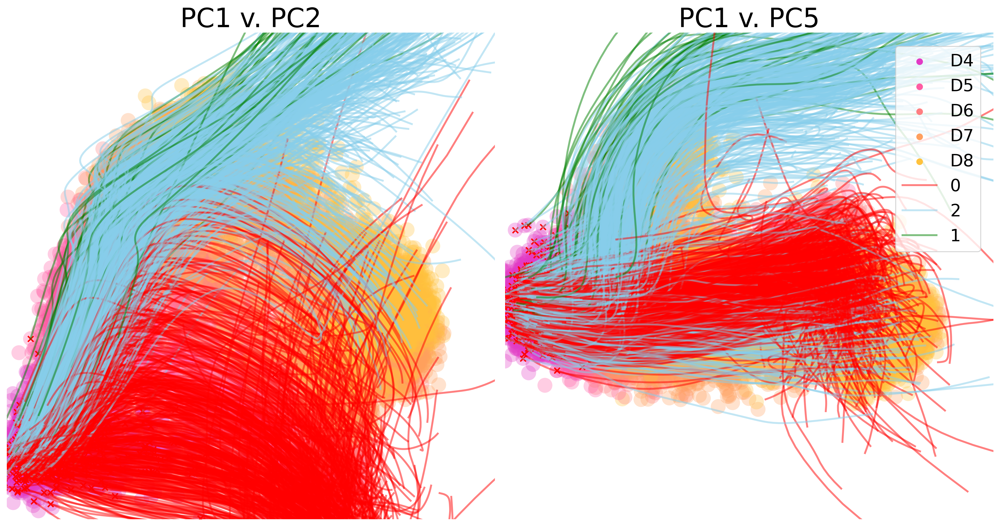

In [11]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {2:'2',0:'0',1:'1'}

z = model.adata.obsm['X_z']
z = torch.tensor(z, device=model.device)

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca = []
for traj in trajectories:
    t_pca.append(pca.transform(traj.detach().cpu().numpy()))

copy = model.adata.copy()
copy.obsm['X_vae'] = z_pca
copy.uns["velocity_params"] = {'embeddings':'vae'}
fig = plt.figure(figsize=(15,8), dpi=300)
ax1, ax2 = fig.subplots(1,2)

scv.pl.scatter(copy, basis='vae', color='timepoint', alpha=0.3, palette=colpal.timepoint,
              ax=ax1, size=1000, show=False, components="1,2",
               legend_loc=False, title="PC1 v. PC2", fontsize=28)
scv.pl.scatter(copy, basis='vae', color='timepoint', alpha=0.3,
              ax=ax2, size=1000, show=False, components="1,5", palette=colpal.timepoint,
               legend_loc='right margin', title="PC1 v. PC5", fontsize=28)
groups = []
for t, cl in zip(t_pca, cluster_labels):
    color = cmap[cl]
    if cl in groups:
        label=''
    else:
        label=clmap[cl]
        groups.append(cl)
    ax1.scatter(t[0,0],t[0,1], color='red', marker='x')
    ax2.scatter(t[0,0],t[0,4], color='red', marker='x')
    ax1.plot(t[:,0],t[:,1], color=color, alpha=.5, linewidth=2, label=label)
    ax2.plot(t[:,0],t[:,4], color=color, alpha=.5, linewidth=2, label=label)
    ax1.set_ylim((-8,10))
    ax1.set_xlim((-8,12))
    ax2.set_ylim((-8,10))
    ax2.set_xlim((-8,12))

    
plt.suptitle("", fontsize=30, y=1.02)
plt.legend(loc=(.8,.55),fontsize=18)
plt.tight_layout()
plt.show()

NameError: name 'n_trajectories' is not defined

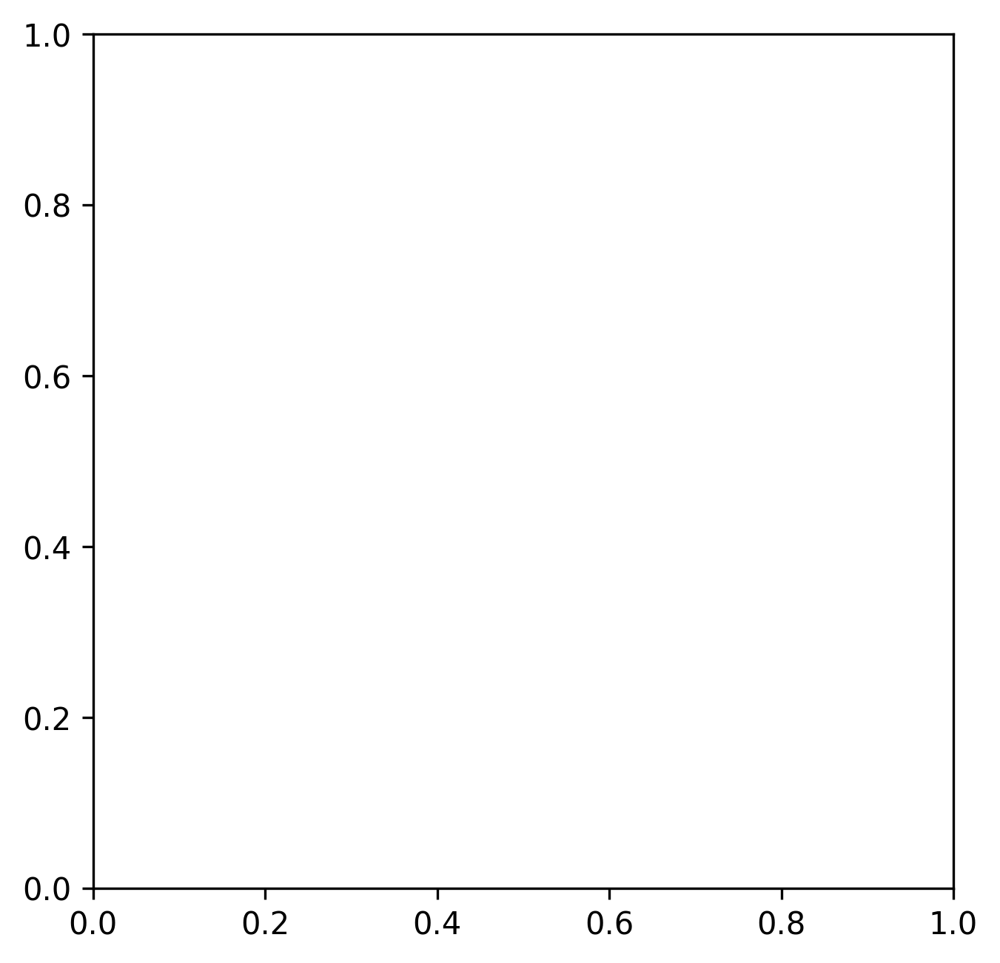

In [12]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {2:'FP Trajectories',1:'V3 Trajectories',0:'MN Trajectories'}

fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.subplots()

components=[0,1]

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca=[]
for i in range(n_trajectories):
    ti = trajectories[i].squeeze().detach().cpu().numpy()
    t_pca.append(pca.transform(ti))
scv.pl.scatter(copy, basis='vae', frameon=True, color='cell_annotation', 
               title='', palette=colpal.celltype, fontsize=22, legend_loc=False, legend_fontsize=17,
              ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
for t in t_pca:
    if one_color:
        ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
    else:
        ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
ax.set_ylim((-8,10))
ax.set_xlim((-8,12))
ax.patch.set_facecolor('red')
ax.patch.set_alpha(0.0)
ax.set_xlabel(f"Latent space PCA {components[0]+1}", fontsize=22)
ax.set_ylabel(f"Latent space PCA {components[1]+1}", fontsize=22)
    
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
# plt.savefig("../figures/2.10.0_untrained_1.png", bbox_inches='tight')
plt.show()

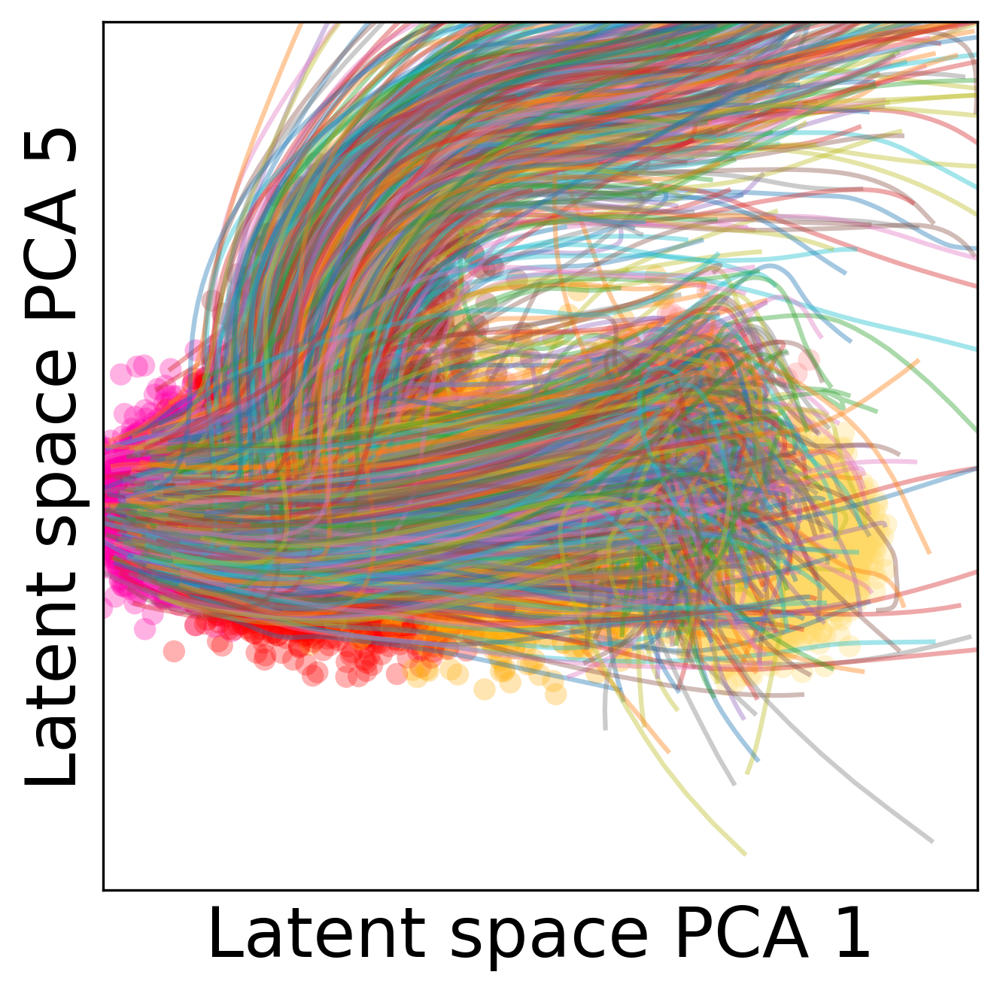

In [127]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {2:'FP Trajectories',1:'V3 Trajectories',0:'MN Trajectories'}

fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.subplots()

components=[0,4]

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca=[]
for i in range(n_trajectories):
    ti = trajectories[i].squeeze().detach().cpu().numpy()
    t_pca.append(pca.transform(ti))
scv.pl.scatter(copy, basis='vae', frameon=True, color='cell_annotation', 
               title='', palette=colpal.celltype, fontsize=22, legend_loc=False, legend_fontsize=17,
              ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
for t in t_pca:
    if one_color:
        ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
    else:
        ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
ax.set_ylim((-8,10))
ax.set_xlim((-8,12))
ax.patch.set_facecolor('red')
ax.patch.set_alpha(0.0)
ax.set_xlabel(f"Latent space PCA {components[0]+1}")
ax.set_ylabel(f"Latent space PCA {components[1]+1}")
    
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
# plt.savefig("../figures/2.10.1_untrained_2.png", bbox_inches='tight')
plt.show()

In [129]:
mn_traj = trajectories[cluster_labels==2]

In [130]:
mn_gex = model.get_trajectory_gene_expression(mn_traj)

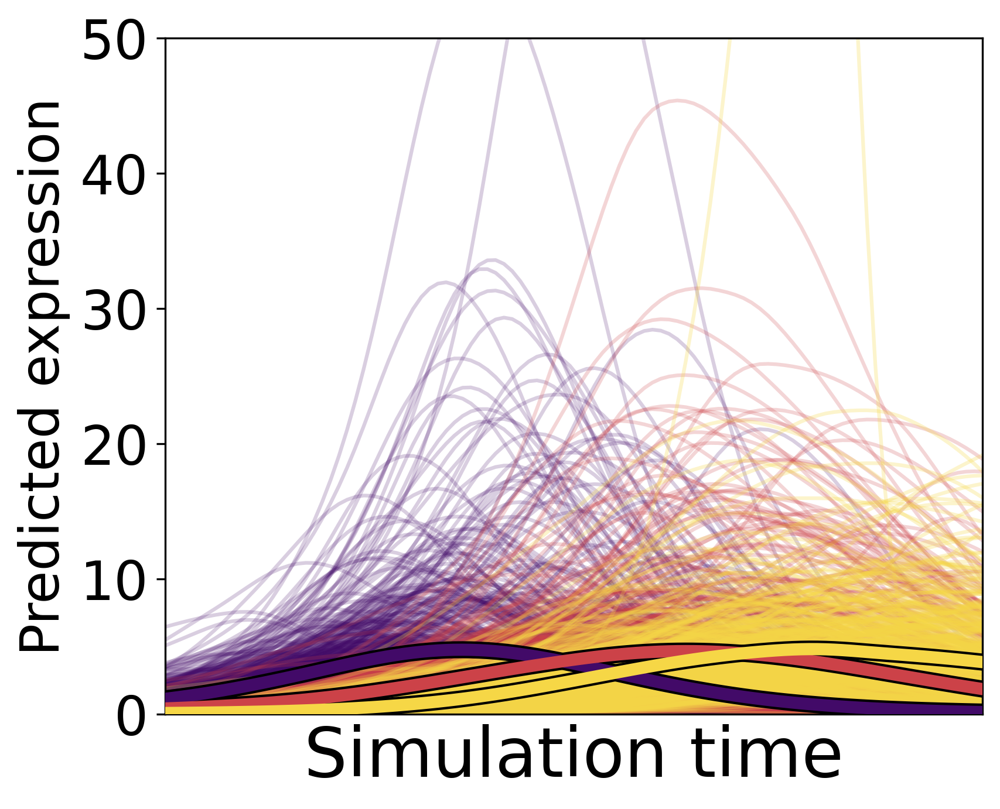

In [131]:
genes = ['Olig2','Isl1','Tubb3']
genedict = {}
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]
for gene in genes:
    results = get_plot_data(mn_gex, gene, mean_normalize=False)
    genedict[gene] = results
    
alphas = [0.2,0.22,.27,0.3]

plt.figure(figsize=(6,5), dpi=300)
for gene, col, alf in zip(genes, colors, alphas):
    ts = genedict[gene][0]
    mu = genedict[gene][1]
    for t in ts:
        plt.plot(t, color=col, alpha=alf)
    plt.plot(mu, linewidth=5, color=col, label=gene, zorder=10)
    plt.plot(mu, linewidth=7, color='black', zorder=9)

plt.title("", fontsize=32)
plt.ylabel("Predicted expression", fontsize=22)
plt.xticks([])
plt.xlabel("Simulation time", fontsize=28)
plt.xlim((0,99))
plt.ylim((0,50))
plt.yticks(fontsize=22)

for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
plt.savefig("../figures/2.10.3_untrained_gex.png", bbox_inches='tight')  
plt.show()

# After Training

In [13]:
initial_cells = model.adata[[ca in ['Early_Neural','Neural'] for ca in model.adata.obs.cell_annotation]]
initial_cells = initial_cells[np.random.choice(initial_cells.shape[0], size=1000, replace=False)]

trajectories, cell_ids = sde_model.simulate(
    initial_cells=initial_cells,
    n_samples_per_cell=1,
    n_steps = 100,
    t_max = 100,
    dt = 1.0,
    latent_key='X_z',
    n_chunks=10
)

Simulating Chunk 9: 100%|██████████| 10/10 [00:00<00:00, 13.06it/s]


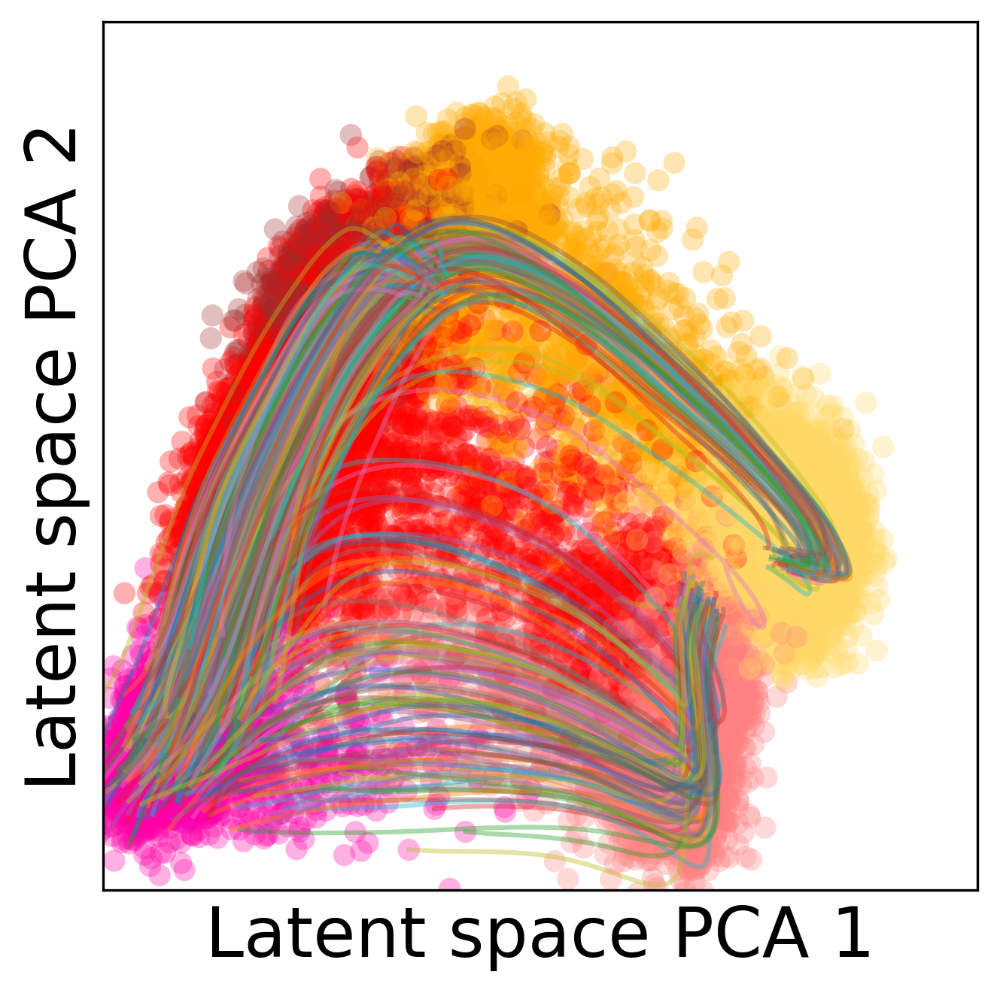

In [18]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {2:'FP Trajectories',1:'V3 Trajectories',0:'MN Trajectories'}

n_trajectories=400
one_color=False

fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.subplots()

components=[0,1]

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca=[]
for i in range(n_trajectories):
    ti = trajectories[i].squeeze().detach().cpu().numpy()
    t_pca.append(pca.transform(ti))
scv.pl.scatter(copy, basis='vae', frameon=True, color='cell_annotation', 
               title='', palette=colpal.celltype, fontsize=22, legend_loc=False, legend_fontsize=17,
              ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
for t in t_pca:
    if one_color:
        ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
    else:
        ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
ax.set_ylim((-8,10))
ax.set_xlim((-8,12))
ax.patch.set_facecolor('red')
ax.patch.set_alpha(0.0)
ax.set_xlabel(f"Latent space PCA {components[0]+1}", fontsize=22)
ax.set_ylabel(f"Latent space PCA {components[1]+1}", fontsize=22)
    
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
# plt.savefig("../figures/2.10.4_trained_1.png", bbox_inches='tight')
plt.show()

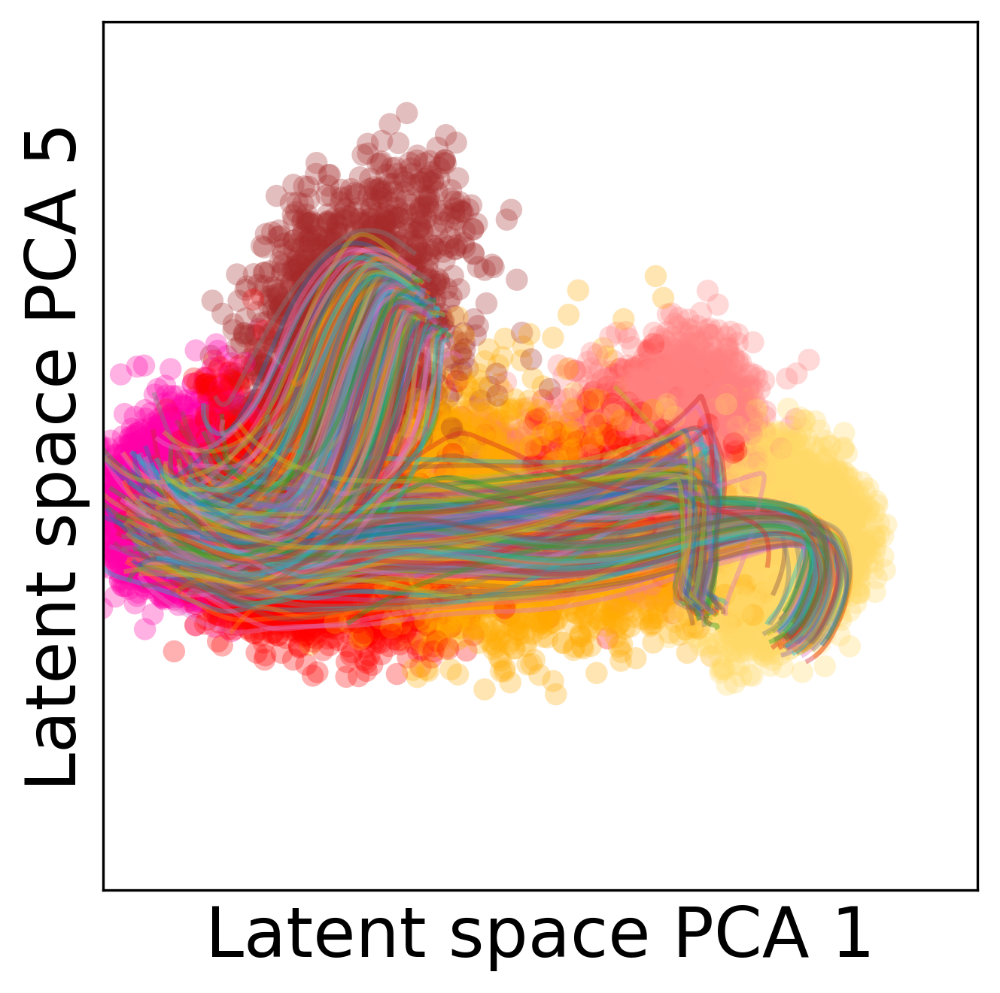

In [19]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {2:'FP Trajectories',1:'V3 Trajectories',0:'MN Trajectories'}

fig = plt.figure(figsize=(5,5), dpi=300)
ax = fig.subplots()

components=[0,4]

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca=[]
for i in range(n_trajectories):
    ti = trajectories[i].squeeze().detach().cpu().numpy()
    t_pca.append(pca.transform(ti))
scv.pl.scatter(copy, basis='vae', frameon=True, color='cell_annotation', 
               title='', palette=colpal.celltype, fontsize=22, legend_loc=False, legend_fontsize=17,
              ax=ax, size=200, alpha=0.3, show=False, components=f"{components[0]+1},{components[1]+1}")
for t in t_pca:
    if one_color:
        ax.plot(t[:,components[0]],t[:,components[1]], color='blue', alpha=alpha)
    else:
        ax.plot(t[:,components[0]],t[:,components[1]], alpha=.4)
ax.set_ylim((-8,10))
ax.set_xlim((-8,12))
ax.patch.set_facecolor('red')
ax.patch.set_alpha(0.0)
ax.set_xlabel(f"Latent space PCA {components[0]+1}", fontsize=22)
ax.set_ylabel(f"Latent space PCA {components[1]+1}", fontsize=22)
    
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
    
# plt.savefig("../figures/2.10.5_trained_2.png", bbox_inches='tight')
plt.show()

In [20]:
%%time
avg_center, labels, centers, index = vt.cl.cluster_trajectories(
    trajectories, 
    n_clusters=3, 
    final_steps=20,
    n_iterations=500
)
cluster_labels = labels.cpu().numpy()

CPU times: user 24.9 s, sys: 822 ms, total: 25.8 s
Wall time: 25.8 s


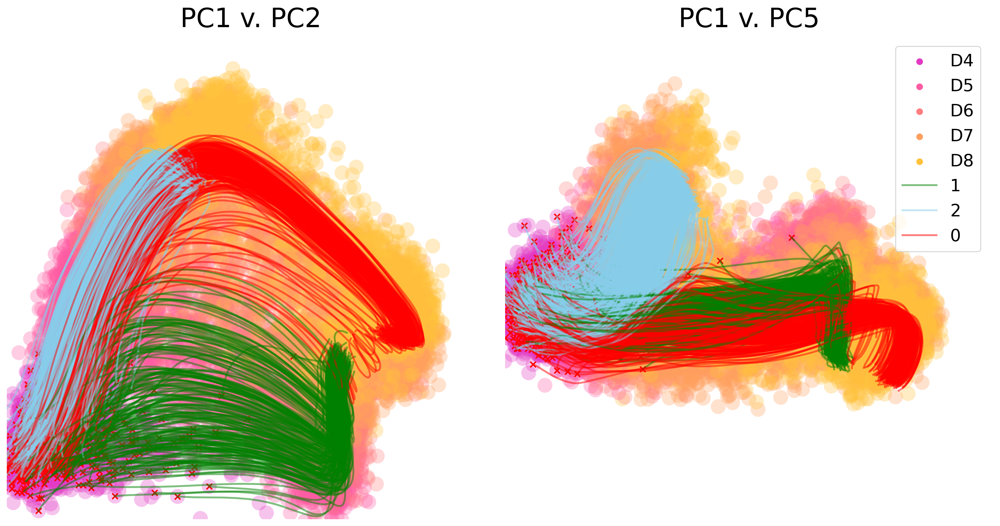

In [21]:
cmap = {2:'#87CEEB',1:'green',0:'#FF0000'}
clmap = {1:'1',0:'0',2:'2'}

z = model.adata.obsm['X_z']
z = torch.tensor(z, device=model.device)

pca = PCA()
z_pca = pca.fit_transform(z.detach().cpu().numpy())

t_pca = []
for traj in trajectories:
    t_pca.append(pca.transform(traj.detach().cpu().numpy()))

copy = model.adata.copy()
copy.obsm['X_vae'] = z_pca
copy.uns["velocity_params"] = {'embeddings':'vae'}
fig = plt.figure(figsize=(15,8), dpi=300)
ax1, ax2 = fig.subplots(1,2)

scv.pl.scatter(copy, basis='vae', color='timepoint', alpha=0.3, palette=colpal.timepoint,
              ax=ax1, size=1000, show=False, components="1,2",
               legend_loc=False, title="PC1 v. PC2", fontsize=28)
scv.pl.scatter(copy, basis='vae', color='timepoint', alpha=0.3,
              ax=ax2, size=1000, show=False, components="1,5", palette=colpal.timepoint,
               legend_loc='right margin', title="PC1 v. PC5", fontsize=28)
groups = []
for t, cl in zip(t_pca, cluster_labels):
    color = cmap[cl]
    if cl in groups:
        label=''
    else:
        label=clmap[cl]
        groups.append(cl)
    ax1.scatter(t[0,0],t[0,1], color='red', marker='x')
    ax2.scatter(t[0,0],t[0,4], color='red', marker='x')
    ax1.plot(t[:,0],t[:,1], color=color, alpha=.5, linewidth=2, label=label)
    ax2.plot(t[:,0],t[:,4], color=color, alpha=.5, linewidth=2, label=label)
    ax1.set_ylim((-8,10))
    ax1.set_xlim((-8,12))
    ax2.set_ylim((-8,10))
    ax2.set_xlim((-8,12))

    
plt.suptitle("", fontsize=30, y=1.02)
plt.legend(loc=(.8,.55),fontsize=18)
plt.tight_layout()
plt.show()

In [22]:
mn_traj = trajectories[cluster_labels==1]

In [23]:
mn_gex = model.get_trajectory_gene_expression(mn_traj)


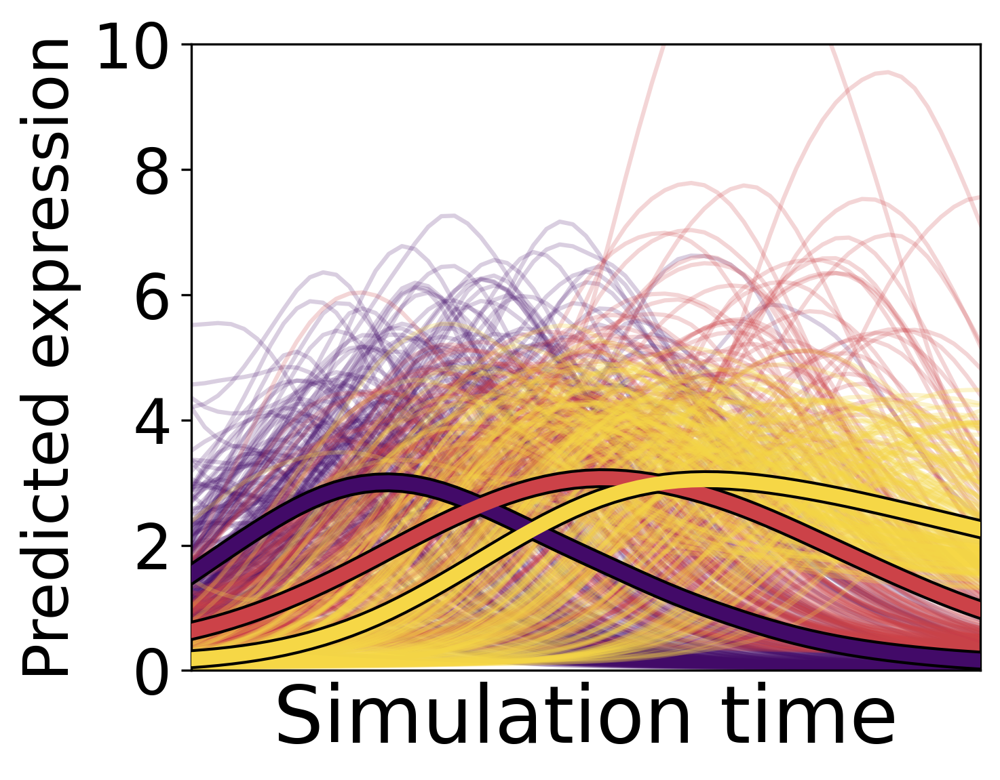

In [35]:
genes = ['Olig2','Isl1','Tubb3']
genedict = {}
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]
for gene in genes:
    results = get_plot_data(mn_gex, gene, mean_normalize=False)
    genedict[gene] = results
    
alphas = [0.2,0.22,.27,0.3]

plt.figure(figsize=(5,4), dpi=300)
for gene, col, alf in zip(genes, colors, alphas):
    ts = genedict[gene][0]
    mu = genedict[gene][1]
    for t in ts:
        plt.plot(t, color=col, alpha=alf)
    plt.plot(mu, linewidth=5, color=col, label=gene, zorder=10)
    plt.plot(mu, linewidth=7, color='black', zorder=9)

plt.title("", fontsize=32)
plt.ylabel("Predicted expression", fontsize=22)
plt.xticks([])
plt.xlabel("Simulation time", fontsize=28)
plt.xlim((0,60))
plt.ylim((0,10))
plt.yticks(fontsize=22)

for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
# plt.savefig("../figures/2.10.6_trained_gex.png", bbox_inches='tight')       
plt.show()

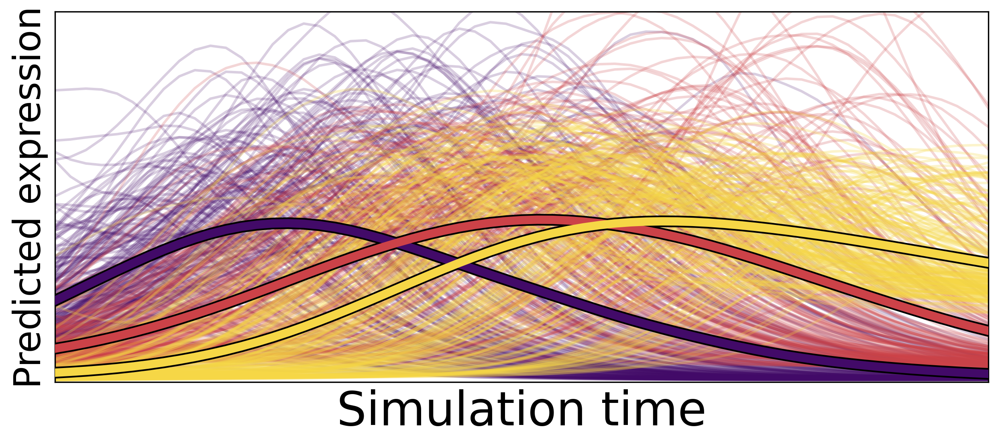

In [40]:
genes = ['Olig2','Isl1','Tubb3']
genedict = {}
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]
for gene in genes:
    results = get_plot_data(mn_gex, gene, mean_normalize=False)
    genedict[gene] = results
    
alphas = [0.2,0.22,.27,0.3]

plt.figure(figsize=(10,4), dpi=300)
for gene, col, alf in zip(genes, colors, alphas):
    ts = genedict[gene][0]
    mu = genedict[gene][1]
    for t in ts:
        plt.plot(t, color=col, alpha=alf)
    plt.plot(mu, linewidth=5, color=col, label=gene, zorder=10)
    plt.plot(mu, linewidth=7, color='black', zorder=9)

plt.title("", fontsize=32)
plt.ylabel("Predicted expression", fontsize=22)
plt.xticks([])
plt.xlabel("Simulation time", fontsize=28)
plt.xlim((0,60))
plt.ylim((0,7))
plt.yticks([],fontsize=22)

for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
# plt.savefig("../figures/2.10.6_trained_gex.png", bbox_inches='tight')       
plt.show()

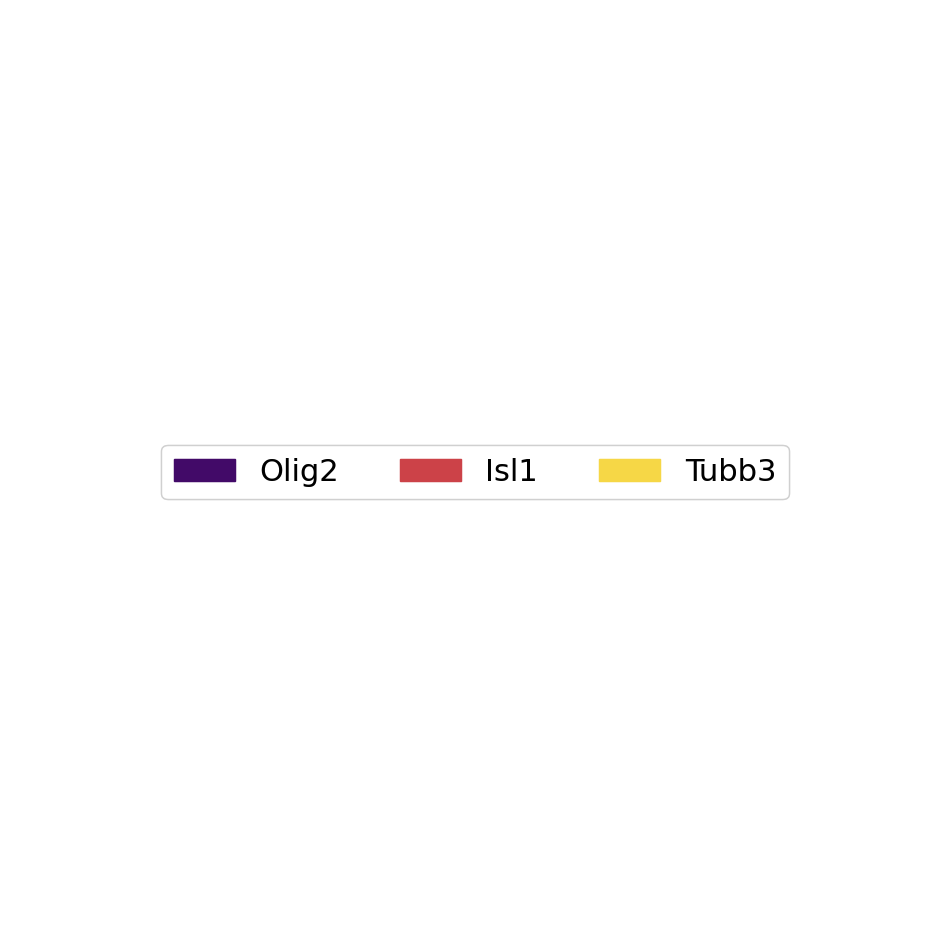

In [27]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

genes = ['Olig2','Isl1','Tubb3']
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]

patches_list = [patches.Patch(color=color, label=gene) for gene, color in zip(genes, colors)]

# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize=(12,12))

# This is the key part: We use patches to create the legend. 
# The plot itself remains empty since we don't plot any data.
legend = ax.legend(handles=patches_list, loc='center', fontsize=22, ncol=3)

# Here we hide all the plot elements to have only the legend visible.
plt.axis('off')
ax.add_artist(legend)
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
plt.savefig("../figures/2.10.7_legend_gex.png", bbox_inches='tight')       
plt.show()


In [28]:
v3_traj = trajectories[cluster_labels==0]
v3_gex = model.get_trajectory_gene_expression(v3_traj)


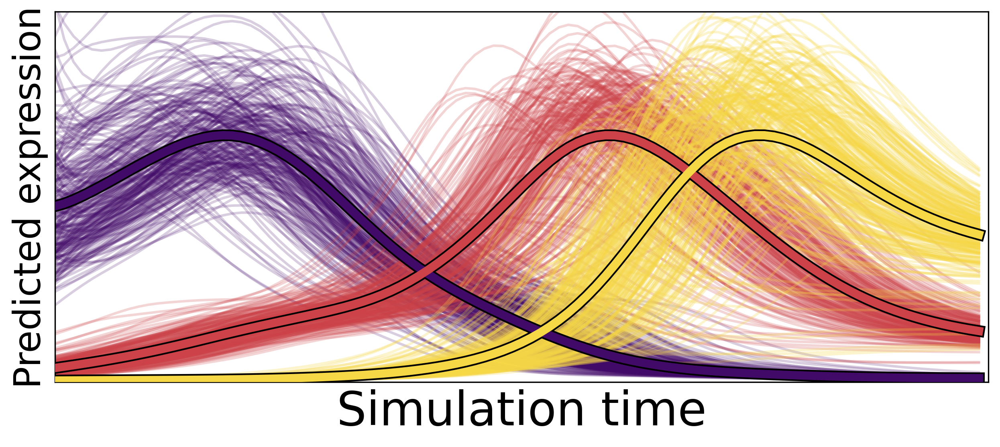

In [42]:
genes = ['Nkx2-9','Nkx2-2','Sim1']
genedict = {}
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]
for gene in genes:
    results = get_plot_data(v3_gex, gene, mean_normalize=True)
    genedict[gene] = results
    
alphas = [0.2,0.22,.27,0.3]

plt.figure(figsize=(10,4), dpi=300)
for gene, col, alf in zip(genes, colors, alphas):
    ts = genedict[gene][0]
    mu = genedict[gene][1]
    for t in ts:
        plt.plot(t, color=col, alpha=alf)
    plt.plot(mu, linewidth=5, color=col, label=gene, zorder=10)
    plt.plot(mu, linewidth=7, color='black', zorder=9)

plt.title("", fontsize=32)
plt.ylabel("Predicted expression", fontsize=22)
plt.xticks([])
plt.xlabel("Simulation time", fontsize=28)
plt.xlim((0,100))
plt.ylim((0,1.5))
plt.yticks([],fontsize=22)

for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
plt.show()

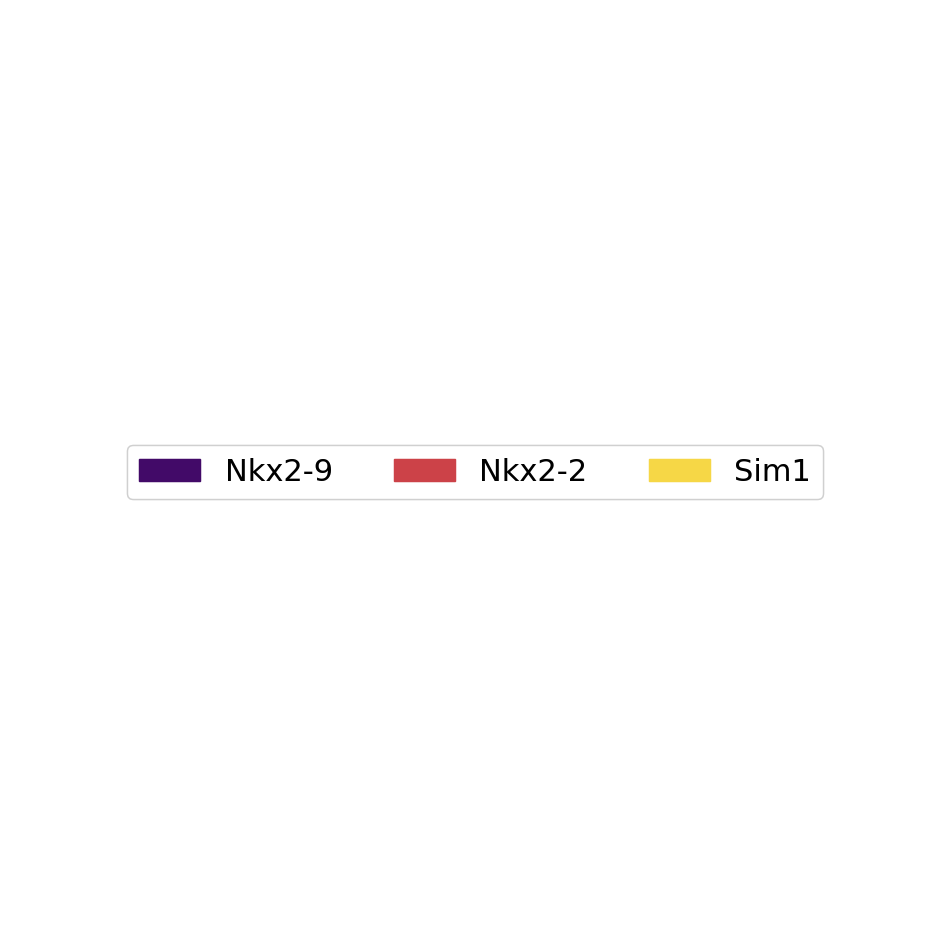

In [43]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

genes = ['Nkx2-9','Nkx2-2','Sim1']
cmap = plt.get_cmap('inferno')
colors = [cmap(i) for i in np.linspace(0.2,0.9,len(genes))]

patches_list = [patches.Patch(color=color, label=gene) for gene, color in zip(genes, colors)]

# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize=(12,12))

# This is the key part: We use patches to create the legend. 
# The plot itself remains empty since we don't plot any data.
legend = ax.legend(handles=patches_list, loc='center', fontsize=22, ncol=3)

# Here we hide all the plot elements to have only the legend visible.
plt.axis('off')
ax.add_artist(legend)
for fig in plt.get_fignums():
    fig = plt.figure(fig)
    # Set the figure facecolor to transparent
    fig.patch.set_facecolor('none')

    # Loop over the axes in the figure
    for ax in fig.get_axes():
        # Set the axes facecolor to white
        ax.set_facecolor('white')
plt.show()
